# **Load Dependencies**

In [10]:
!pip install pycaret

In [11]:
import pandas as pd
from pycaret.clustering import *

# **Load Data**

In [14]:
df = pd.read_csv("Supermarket Data.csv")

In [15]:
df['SHOP_DATE'] = df['SHOP_DATE'].apply(lambda x: pd.to_datetime(str(x), format='%Y%m%d'))

In [18]:
df.tail(5)

,SHOP_WEEK,SHOP_DATE,SHOP_WEEKDAY,SHOP_HOUR,QUANTITY,SPEND,PROD_CODE,PROD_CODE_10,PROD_CODE_20,PROD_CODE_30,PROD_CODE_40,CUST_CODE,CUST_PRICE_SENSITIVITY,CUST_LIFESTAGE,BASKET_ID,BASKET_SIZE,BASKET_PRICE_SENSITIVITY,BASKET_TYPE,BASKET_DOMINANT_MISSION,STORE_CODE,STORE_FORMAT,STORE_REGION
956569,200617,2006-06-22,5,12,3,3.96,PRD0904997,CL00074,DEP00021,G00007,D00002,NaN,NaN,NaN,994101100088778,M,MM,Top Up,Fresh,STORE00002,LS,W01
956570,200633,2006-10-13,6,20,3,3.96,PRD0904997,CL00074,DEP00021,G00007,D00002,NaN,NaN,NaN,994102700099738,L,LA,Top Up,Fresh,STORE00002,LS,W01
956571,200617,2006-06-22,5,18,3,3.96,PRD0904997,CL00074,DEP00021,G00007,D00002,CUST0000544241,LA,YA,994101100506174,L,LA,Top Up,Fresh,STORE00002,LS,W01
956572,200619,2006-07-06,5,19,3,3.96,PRD0904997,CL00074,DEP00021,G00007,D00002,CUST0000423155,LA,YF,994101300433650,L,LA,Full Shop,Fresh,STORE00002,LS,W01
956573,200635,2006-10-23,2,21,3,3.96,PRD0904997,CL00074,DEP00021,G00007,D00002,NaN,NaN,NaN,994102900104676,L,MM,Top Up,Fresh,STORE00002,LS,W01


In [19]:
df.info

<bound method DataFrame.info of         SHOP_WEEK  SHOP_DATE  SHOP_WEEKDAY  SHOP_HOUR  QUANTITY  SPEND  \
0          200732 2007-10-05             6         17         3   6.75   
1          200733 2007-10-10             4         20         3   6.75   
2          200741 2007-12-09             1         11         1   2.25   
3          200731 2007-09-29             7         17         1   2.25   
4          200737 2007-11-10             7         14         3   6.75   
...           ...        ...           ...        ...       ...    ...   
956569     200617 2006-06-22             5         12         3   3.96   
956570     200633 2006-10-13             6         20         3   3.96   
956571     200617 2006-06-22             5         18         3   3.96   
956572     200619 2006-07-06             5         19         3   3.96   
956573     200635 2006-10-23             2         21         3   3.96   

         PROD_CODE PROD_CODE_10 PROD_CODE_20 PROD_CODE_30 PROD_CODE_40  \
0    

# **Prepare customer single view**
## *Only Membership customer

# Define features

Total visits = COUNT(DISTINCT BASKET ID)

Ticket size = SUM(SPEND)/COUNT(DISTINCT BASKET ID)

Total no. of SKUs


# Calculate features

In [20]:
##prepare customer single view
df_csv = df_groupby = df[df['CUST_CODE'].notnull()].groupby(by=['CUST_CODE']).agg(TotalSpend=('SPEND', 'sum'),
                                                                                  TotalVisits=('BASKET_ID', 'nunique'),
                                                                                  TotalSKUs=('PROD_CODE', 'nunique'),
                                                                                  FirstDate=('SHOP_DATE', 'min'),
                                                                                  LastDate=('SHOP_DATE', 'max')
                                                                                  ).reset_index()

In [21]:
##calculate ticket size
df_csv['TicketSize'] = df_csv['TotalSpend']/df_csv['TotalVisits']

In [22]:
##find max date in the dataset
max_date = df_csv['LastDate'].max()

In [23]:
##calculate total days of the relationship
df_csv['total_days'] = (df_csv['LastDate'] - df_csv['FirstDate']).dt.days + 1

In [24]:
##calculate recency days
df_csv['recency'] = (max_date - df_csv['LastDate']).dt.days

In [27]:
df_csv.head(5)

,CUST_CODE,TotalSpend,TotalVisits,TotalSKUs,FirstDate,LastDate,TicketSize,total_days,recency
0,CUST0000000181,2.44,1,1,2007-01-06,2007-01-06,2.440000,1,547
1,CUST0000000369,959.33,220,189,2006-04-16,2008-07-05,4.360591,812,1
2,CUST0000000689,328.57,16,116,2007-07-22,2008-06-23,20.535625,338,13
3,CUST0000000998,5.95,3,4,2006-05-04,2006-07-07,1.983333,65,730
4,CUST0000001163,39.74,4,24,2006-10-22,2008-06-22,9.935000,610,14


# **Cluster customers**

In [28]:
exp_clu = setup(data=df_csv, ignore_features=['CUST_CODE','FirstDate', 'LastDate'], normalize=True)

,Description,Value
0,session_id,6708
1,Original Data,"(6100, 9)"
2,Missing Values,False
3,Numeric Features,6
4,Categorical Features,0
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(6100, 6)"
9,CPU Jobs,-1


In [29]:
models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


In [30]:
get_metrics()

,Name,Display Name,Score Function,Scorer,Target,Args,Greater is Better,Needs Ground Truth,Custom
ID,,,,,,,,,
silhouette,Silhouette,Silhouette,<function silhouette_score at 0x000001FB5DAC4940>,make_scorer(silhouette_score),pred,{},True,False,False
chs,Calinski-Harabasz,Calinski-Harabasz,<function calinski_harabasz_score at 0x000001F...,make_scorer(calinski_harabasz_score),pred,{},True,False,False
db,Davies-Bouldin,Davies-Bouldin,<function davies_bouldin_score at 0x000001FB5D...,make_scorer(davies_bouldin_score),pred,{},True,False,False
hs,Homogeneity Score,Homogeneity,<function homogeneity_score at 0x000001FB5DA99...,make_scorer(homogeneity_score),pred,{},True,True,False
ari,Rand Index,Rand Index,<function adjusted_rand_score at 0x000001FB5DA...,make_scorer(adjusted_rand_score),pred,{},True,True,False
cs,Completeness Score,Completeness,<function completeness_score at 0x000001FB5DAA...,make_scorer(completeness_score),pred,{},True,True,False


# Compare model performance

In [31]:
metrics = []
for model in models().index:
    if model in ['meanshift', 'optics']:
        continue
    create_model(model)
    metric_result = pull()
    metric_result['model'] = model
    metrics.append(metric_result)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.1711,97.1614,5.6634,0,0,0


In [32]:
cluster_metrics = pd.concat(metrics)
cluster_metrics.set_index("model", inplace=True)
cluster_metrics.sort_values(by='Silhouette', ascending=False, inplace=True)
cluster_metrics.style.highlight_max(subset=['Silhouette', 'Calinski-Harabasz'], color = 'green', axis = 0).highlight_min(subset=['Davies-Bouldin'], color = 'green', axis = 0)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
model,,,,,,
sc,0.764200,70.662300,0.175200,0,0,0
birch,0.450100,1863.849900,0.841900,0,0,0
kmeans,0.439400,3792.613900,0.878600,0,0,0
dbscan,0.374800,424.315100,1.063900,0,0,0
hclust,0.352100,2891.687100,0.997400,0,0,0
ap,0.000000,0.000000,0.000000,0,0,0
kmodes,-0.171100,97.161400,5.663400,0,0,0


From table above, we can see that sc(Spectral Clustering) model have best silhouette coefficient value out of all models.At the same time kmeans model have the best Calinski-Harabasz score.

# Spectral Clustering 

In [33]:
sc = create_model('sc')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7642,70.6623,0.1752,0,0,0


In [34]:
plot_model(sc)

This model is not good because most of the data is in the same cluster(cluster 0)

# KMeans Clustering

In [35]:
kmeans = create_model('kmeans')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4394,3792.6139,0.8786,0,0,0


In [36]:
print(kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=6708, tol=0.0001, verbose=0)


In [37]:
plot_model(kmeans)

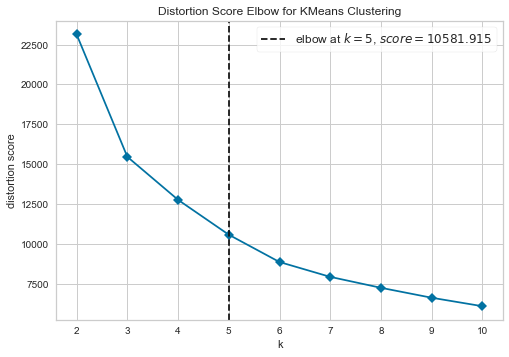

In [38]:
plot_model(kmeans, plot = 'elbow')

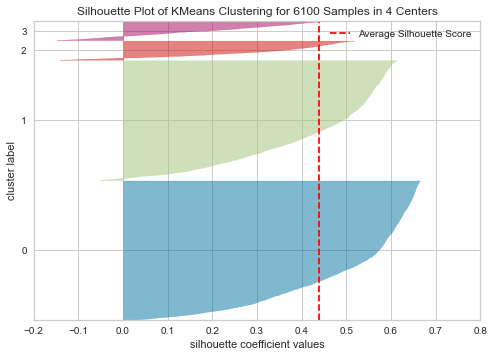

In [39]:
plot_model(kmeans, plot = 'silhouette')


From this silhouette coefficient score, it show that this kmean model clustering is somewhat fine to use as a clustering model because it's average silhouette score about 0.4394 which is not bad but not good either

In [43]:
plot_model(kmeans, plot = 'distribution')

# Affinity Propagation Clustering model

In [46]:
ap = create_model('ap')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0,0,0,0,0,0


In [47]:
plot_model(ap)

Ap model is not working for this dataset

# **Interpret results and plan for actions**

In [45]:
kmeans_results = assign_model(kmeans)
kmeans_results

,CUST_CODE,TotalSpend,TotalVisits,TotalSKUs,FirstDate,LastDate,TicketSize,total_days,recency,Cluster
0,CUST0000000181,2.44,1,1,2007-01-06,2007-01-06,2.440000,1,547,Cluster 0
1,CUST0000000369,959.33,220,189,2006-04-16,2008-07-05,4.360591,812,1,Cluster 2
2,CUST0000000689,328.57,16,116,2007-07-22,2008-06-23,20.535625,338,13,Cluster 1
3,CUST0000000998,5.95,3,4,2006-05-04,2006-07-07,1.983333,65,730,Cluster 0
4,CUST0000001163,39.74,4,24,2006-10-22,2008-06-22,9.935000,610,14,Cluster 1
...,...,...,...,...,...,...,...,...,...,...
6095,CUST0000999593,453.58,30,206,2006-05-06,2008-04-02,15.119333,698,95,Cluster 1
6096,CUST0000999645,105.11,11,46,2006-04-30,2008-05-08,9.555455,740,59,Cluster 1
6097,CUST0000999654,5.86,1,4,2006-06-25,2006-06-25,5.860000,1,742,Cluster 0
6098,CUST0000999935,444.17,21,127,2006-11-29,2008-06-05,21.150952,555,31,Cluster 1


In [49]:
plot_model(kmeans, plot = 'distribution', feature = 'TotalSpend',scale = 0.5)

In [50]:
plot_model(kmeans, plot = 'distribution', feature = 'TotalVisits',scale = 0.5)

In [51]:
plot_model(kmeans, plot = 'distribution', feature = 'TotalSKUs',scale = 0.5)

In [52]:
plot_model(kmeans, plot = 'distribution', feature = 'TicketSize',scale = 0.5)

In [53]:
plot_model(kmeans, plot = 'distribution', feature = 'total_days',scale = 0.5)

In [54]:
plot_model(kmeans, plot = 'distribution', feature = 'recency',scale = 0.5)

# Summaries


> from 956574 transaction all across stores. It's found that the data have only 6100 unique customers which are members(have CUST_CODE)

<li>Cluster 0: One-time Customers</li>
<blockquote>the group of customers that have the least visits and have been absent for a long time(maybe they're churn customers) <br> --- This group of customers is the least contributor to our stores </blockquote>
<li>Cluster 1: Longtime and Faithful Customers</li>
<blockquote>the group of customers that frequently visit our stores but didn't buy much<br> --- This group of customers need some promotion campaign to increase their desire to spend some more money to our stores </blockquote>
<li>Cluster 2: Advocate Customers</li>
<blockquote>the most important customers that contribute a lots to our stores<br> --- This group of customers have the most loyalty to our business so we should engage and keep them as long as possible </blockquote>
<li>Cluster 3: New comer Customers</li>
<blockquote>new wandering customer that engage with our stores<br> --- For this group of customers,we should advertise them to convey them to be more loyal and use our services a lot more in future </blockquote>